In [33]:
from google.colab import drive

In [34]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [35]:
workspace_dir = "."
!cp "/content/drive/MyDrive/CSCI720/Motor_Vehicle_Collisions_-_Crashes_20231118.csv" "{workspace_dir}"

In [36]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import display
import seaborn as sns

In [37]:
ny_crash_df = pd.read_csv('/content/Motor_Vehicle_Collisions_-_Crashes_20231118.csv')

<ipython-input-37-a008b9327cc6>:1: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  ny_crash_df = pd.read_csv('/content/Motor_Vehicle_Collisions_-_Crashes_20231118.csv')


Exploring the Data

In [38]:
display(ny_crash_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2042904 entries, 0 to 2042903
Data columns (total 29 columns):
 #   Column                         Dtype  
---  ------                         -----  
 0   CRASH DATE                     object 
 1   CRASH TIME                     object 
 2   BOROUGH                        object 
 3   ZIP CODE                       object 
 4   LATITUDE                       float64
 5   LONGITUDE                      float64
 6   LOCATION                       object 
 7   ON STREET NAME                 object 
 8   CROSS STREET NAME              object 
 9   OFF STREET NAME                object 
 10  NUMBER OF PERSONS INJURED      float64
 11  NUMBER OF PERSONS KILLED       float64
 12  NUMBER OF PEDESTRIANS INJURED  int64  
 13  NUMBER OF PEDESTRIANS KILLED   int64  
 14  NUMBER OF CYCLIST INJURED      int64  
 15  NUMBER OF CYCLIST KILLED       int64  
 16  NUMBER OF MOTORIST INJURED     int64  
 17  NUMBER OF MOTORIST KILLED      int64  
 18  CO

None

In [39]:
display(ny_crash_df.head())

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
0,09/11/2021,2:39,NaN,NaN,NaN,NaN,NaN,WHITESTONE EXPRESSWAY,20 AVENUE,NaN,...,Unspecified,NaN,NaN,NaN,4455765,Sedan,Sedan,NaN,NaN,NaN
1,03/26/2022,11:45,NaN,NaN,NaN,NaN,NaN,QUEENSBORO BRIDGE UPPER,NaN,NaN,...,NaN,NaN,NaN,NaN,4513547,Sedan,NaN,NaN,NaN,NaN
2,06/29/2022,6:55,NaN,NaN,NaN,NaN,NaN,THROGS NECK BRIDGE,NaN,NaN,...,Unspecified,NaN,NaN,NaN,4541903,Sedan,Pick-up Truck,NaN,NaN,NaN
3,09/11/2021,9:35,BROOKLYN,11208.0,40.667202,-73.866500,"(40.667202, -73.8665)",NaN,NaN,1211 LORING AVENUE,...,NaN,NaN,NaN,NaN,4456314,Sedan,NaN,NaN,NaN,NaN
4,12/14/2021,8:13,BROOKLYN,11233.0,40.683304,-73.917274,"(40.683304, -73.917274)",SARATOGA AVENUE,DECATUR STREET,NaN,...,NaN,NaN,NaN,NaN,4486609,NaN,NaN,NaN,NaN,NaN


In [40]:
print("Null values in dataset by each column:")
print(ny_crash_df.isnull().sum())

print("\nNumber of Duplicates: ", ny_crash_df.duplicated().sum())


Null values in dataset by each column:
CRASH DATE                             0
CRASH TIME                             0
BOROUGH                           635526
ZIP CODE                          635770
LATITUDE                          231535
LONGITUDE                         231535
LOCATION                          231535
ON STREET NAME                    431621
CROSS STREET NAME                 767979
OFF STREET NAME                  1703656
NUMBER OF PERSONS INJURED             18
NUMBER OF PERSONS KILLED              31
NUMBER OF PEDESTRIANS INJURED          0
NUMBER OF PEDESTRIANS KILLED           0
NUMBER OF CYCLIST INJURED              0
NUMBER OF CYCLIST KILLED               0
NUMBER OF MOTORIST INJURED             0
NUMBER OF MOTORIST KILLED              0
CONTRIBUTING FACTOR VEHICLE 1       6526
CONTRIBUTING FACTOR VEHICLE 2     313561
CONTRIBUTING FACTOR VEHICLE 3    1897568
CONTRIBUTING FACTOR VEHICLE 4    2010232
CONTRIBUTING FACTOR VEHICLE 5    2034057
COLLISION_ID      

In [41]:
queens_df = ny_crash_df[ny_crash_df['BOROUGH']=="QUEENS"]
display(queens_df.head())
print("There are: ", len(queens_df), " records of crashes in Queens Borough")

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
11,12/14/2021,16:50,QUEENS,11413.0,40.675884,-73.75577,"(40.675884, -73.75577)",SPRINGFIELD BOULEVARD,EAST GATE PLAZA,NaN,...,Unspecified,NaN,NaN,NaN,4487127,Sedan,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN
14,12/14/2021,23:10,QUEENS,11434.0,40.666840,-73.78941,"(40.66684, -73.78941)",NORTH CONDUIT AVENUE,150 STREET,NaN,...,Unspecified,NaN,NaN,NaN,4486635,Sedan,Sedan,NaN,NaN,NaN
22,12/13/2021,6:30,QUEENS,11372.0,40.753730,-73.88505,"(40.75373, -73.88505)",82 STREET,34 AVENUE,NaN,...,NaN,NaN,NaN,NaN,4486967,Sedan,NaN,NaN,NaN,NaN
30,12/12/2021,9:00,QUEENS,11385.0,40.704470,-73.90148,"(40.70447, -73.90148)",NaN,NaN,59-14 67 AVENUE,...,Unspecified,NaN,NaN,NaN,4486933,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN,NaN
44,04/24/2022,6:00,QUEENS,11411.0,0.000000,0.00000,"(0.0, 0.0)",NaN,NaN,116-44 234 STREET,...,Unspecified,NaN,NaN,NaN,4521460,Sedan,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN


There are:  377010  records of crashes in Queens Borough


In [42]:
print("Null values in dataset by each column:")
print(len(queens_df) - queens_df.isnull().sum())

Null values in dataset by each column:
CRASH DATE                       377010
CRASH TIME                       377010
BOROUGH                          377010
ZIP CODE                         376803
LATITUDE                         368572
LONGITUDE                        368572
LOCATION                         368572
ON STREET NAME                   299554
CROSS STREET NAME                299210
OFF STREET NAME                   77323
NUMBER OF PERSONS INJURED        377007
NUMBER OF PERSONS KILLED         377006
NUMBER OF PEDESTRIANS INJURED    377010
NUMBER OF PEDESTRIANS KILLED     377010
NUMBER OF CYCLIST INJURED        377010
NUMBER OF CYCLIST KILLED         377010
NUMBER OF MOTORIST INJURED       377010
NUMBER OF MOTORIST KILLED        377010
CONTRIBUTING FACTOR VEHICLE 1    375988
CONTRIBUTING FACTOR VEHICLE 2    319775
CONTRIBUTING FACTOR VEHICLE 3     27125
CONTRIBUTING FACTOR VEHICLE 4      6234
CONTRIBUTING FACTOR VEHICLE 5      1723
COLLISION_ID                     377010
V

**Cleaning and Preprocessing Data**

In [43]:
queens_df['CRASH DATE'] = pd.to_datetime(queens_df['CRASH DATE'], errors='coerce', format='%m/%d/%Y')
queens_df['CRASH TIME'] = pd.to_datetime(queens_df['CRASH TIME'], errors='coerce', format='%H:%M')


# Dropping unnecessary columns
columns_to_drop = ['LOCATION', 'COLLISION_ID']

queens_df = queens_df.drop(columns=columns_to_drop)


<ipython-input-43-b263328d0ea8>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  queens_df['CRASH DATE'] = pd.to_datetime(queens_df['CRASH DATE'], errors='coerce', format='%m/%d/%Y')
<ipython-input-43-b263328d0ea8>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  queens_df['CRASH TIME'] = pd.to_datetime(queens_df['CRASH TIME'], errors='coerce', format='%H:%M')


In [44]:
display(queens_df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 377010 entries, 11 to 2042903
Data columns (total 27 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   CRASH DATE                     377010 non-null  datetime64[ns]
 1   CRASH TIME                     377010 non-null  datetime64[ns]
 2   BOROUGH                        377010 non-null  object        
 3   ZIP CODE                       376803 non-null  object        
 4   LATITUDE                       368572 non-null  float64       
 5   LONGITUDE                      368572 non-null  float64       
 6   ON STREET NAME                 299554 non-null  object        
 7   CROSS STREET NAME              299210 non-null  object        
 8   OFF STREET NAME                77323 non-null   object        
 9   NUMBER OF PERSONS INJURED      377007 non-null  float64       
 10  NUMBER OF PERSONS KILLED       377006 non-null  float64       
 11

None

In [45]:
# Filter data for June and July of 2019 and 2020
filtered_df = queens_df[
    ((queens_df['CRASH DATE'].dt.month == 6) | (queens_df['CRASH DATE'].dt.month == 7)) &
    ((queens_df['CRASH DATE'].dt.year == 2019) | (queens_df['CRASH DATE'].dt.year == 2020))
]

print("Number of crashes in June and July of 2019 and 2020: ", len(filtered_df))

Number of crashes in June and July of 2019 and 2020:  10305


In [46]:
crashes_per_day = filtered_df['CRASH DATE'].dt.date.value_counts().sort_index()

crashes_per_day = filtered_df.groupby(filtered_df['CRASH DATE'].dt.date).size()
print("Crashes per day:")
print(crashes_per_day)


Crashes per day:
CRASH DATE
2019-06-01    109
2019-06-02    105
2019-06-03    132
2019-06-04    128
2019-06-05    115
             ... 
2020-07-27     60
2020-07-28     52
2020-07-29     47
2020-07-30     51
2020-07-31     47
Length: 122, dtype: int64


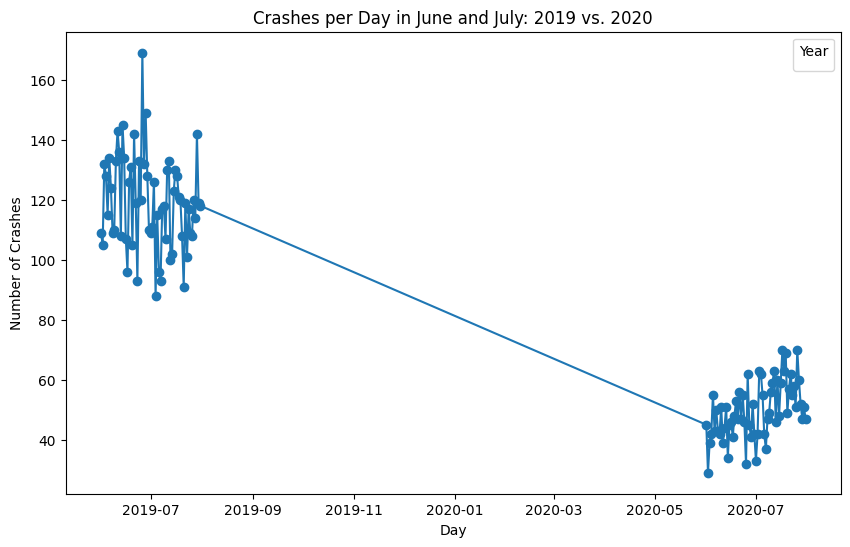

In [47]:
# Plot the changes
crashes_per_day.plot(marker='o', linestyle='-', figsize=(10, 6))
plt.title('Crashes per Day in June and July: 2019 vs. 2020')
plt.xlabel('Day')
plt.ylabel('Number of Crashes')
plt.legend(title='Year')
plt.show()

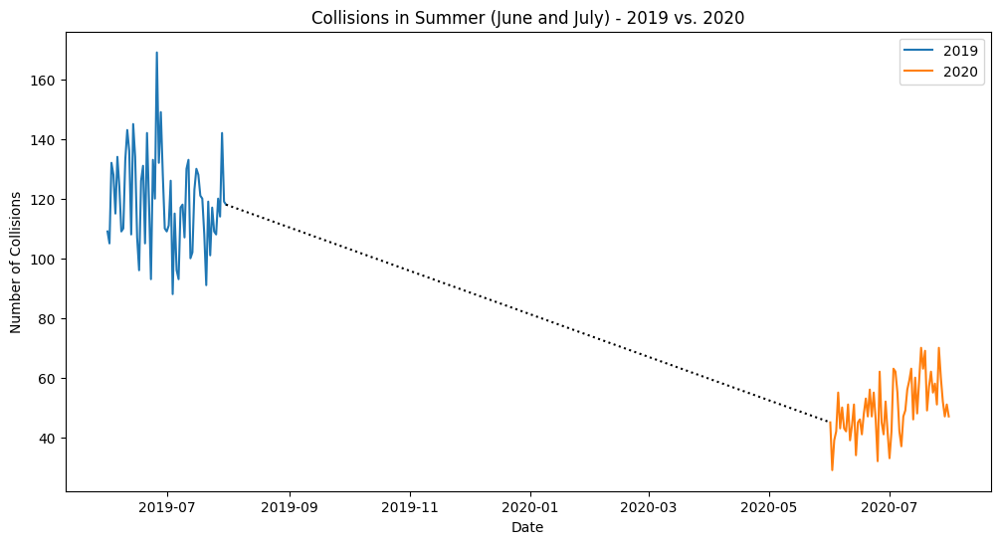

In [48]:
#Q1

summer_2019 = queens_df[(queens_df['CRASH DATE'] >= '2019-06-01') & (queens_df['CRASH DATE'] <= '2019-07-31')]
summer_2020 = queens_df[(queens_df['CRASH DATE'] >= '2020-06-01') & (queens_df['CRASH DATE'] <= '2020-07-31')]

# Count collisions for each day
collisions_2019 = summer_2019.groupby('CRASH DATE').size()
collisions_2020 = summer_2020.groupby('CRASH DATE').size()

# Plotting the difference
plt.figure(figsize=(12, 6))
plt.plot(collisions_2019.index, collisions_2019.values, label='2019')
plt.plot(collisions_2020.index, collisions_2020.values, label='2020')

# Connect the last point of 2019 with the first point of 2020 using a dotted line
plt.plot([collisions_2019.index[-1], collisions_2020.index[0]],
         [collisions_2019.values[-1], collisions_2020.values[0]],
         linestyle='dotted', color='black')

plt.title('Collisions in Summer (June and July) - 2019 vs. 2020')
plt.xlabel('Date')
plt.ylabel('Number of Collisions')
plt.legend()
plt.show()

In [49]:
june_2019 = queens_df[(queens_df['CRASH DATE'].dt.month == 6) & (queens_df['CRASH DATE'].dt.year == 2019)]
june_2020 = queens_df[(queens_df['CRASH DATE'].dt.month == 6) & (queens_df['CRASH DATE'].dt.year == 2020)]

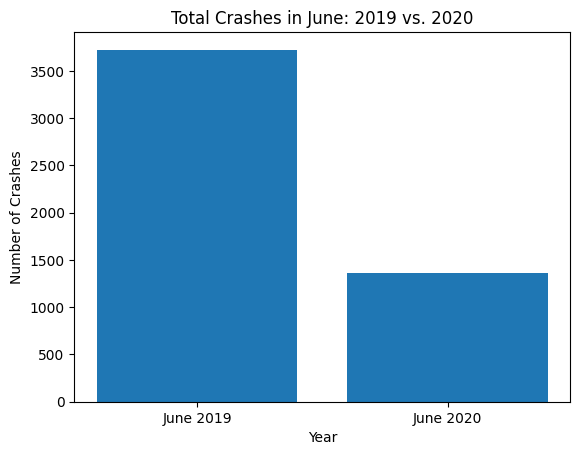

In [50]:
plt.bar(['June 2019', 'June 2020'], [len(june_2019), len(june_2020)])
plt.title('Total Crashes in June: 2019 vs. 2020')
plt.xlabel('Year')
plt.ylabel('Number of Crashes')
plt.show()

In [51]:
# List of attributes (columns) to compare
attributes_to_compare = ['NUMBER OF PERSONS INJURED', 'NUMBER OF PERSONS KILLED',
                         'NUMBER OF PEDESTRIANS INJURED','NUMBER OF PEDESTRIANS KILLED',
                         'NUMBER OF CYCLIST INJURED','NUMBER OF CYCLIST KILLED',
                         'NUMBER OF MOTORIST INJURED', 'NUMBER OF MOTORIST KILLED']

In [52]:
print(june_2019[attributes_to_compare].sum())
print(june_2020[attributes_to_compare].sum())

NUMBER OF PERSONS INJURED        1103.0
NUMBER OF PERSONS KILLED            1.0
NUMBER OF PEDESTRIANS INJURED     141.0
NUMBER OF PEDESTRIANS KILLED        0.0
NUMBER OF CYCLIST INJURED          91.0
NUMBER OF CYCLIST KILLED            0.0
NUMBER OF MOTORIST INJURED        871.0
NUMBER OF MOTORIST KILLED           1.0
dtype: float64
NUMBER OF PERSONS INJURED        581.0
NUMBER OF PERSONS KILLED           3.0
NUMBER OF PEDESTRIANS INJURED     71.0
NUMBER OF PEDESTRIANS KILLED       1.0
NUMBER OF CYCLIST INJURED        106.0
NUMBER OF CYCLIST KILLED           0.0
NUMBER OF MOTORIST INJURED       404.0
NUMBER OF MOTORIST KILLED          2.0
dtype: float64


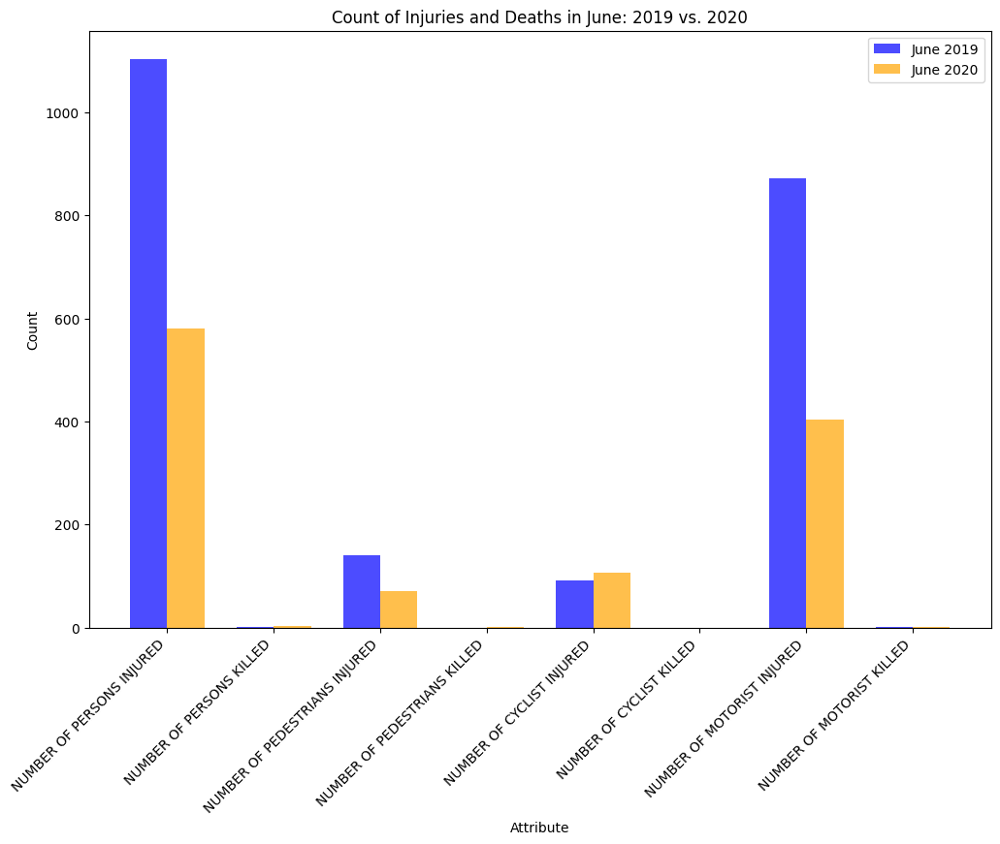

In [53]:
bar_width = 0.35
index = range(len(attributes_to_compare))

plt.figure(figsize=(12, 8))

# Bar chart for June 2019
plt.bar(index, june_2019[attributes_to_compare].sum(), bar_width, label='June 2019', color='blue', alpha=0.7)

# Bar chart for June 2020
plt.bar([i + bar_width for i in index], june_2020[attributes_to_compare].sum(), bar_width, label='June 2020', color='orange', alpha=0.7)

plt.title('Count of Injuries and Deaths in June: 2019 vs. 2020')
plt.xlabel('Attribute')
plt.ylabel('Count')
plt.xticks([i + bar_width/2 for i in index], attributes_to_compare, rotation=45, ha='right')
plt.legend()
plt.show()

<Figure size 1200x800 with 0 Axes>

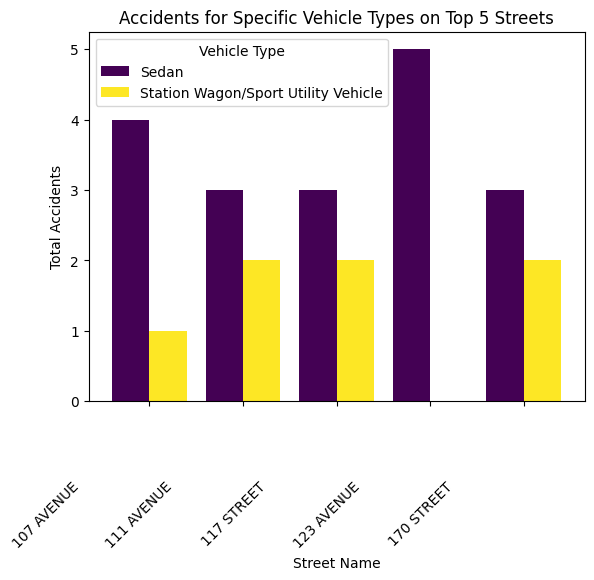

In [54]:
import pandas as pd
import matplotlib.pyplot as plt


# Filter out rows with missing values in relevant columns
filtered_df = summer_2019[['ON STREET NAME', 'VEHICLE TYPE CODE 1', 'VEHICLE TYPE CODE 2',
                          'VEHICLE TYPE CODE 3', 'VEHICLE TYPE CODE 4', 'VEHICLE TYPE CODE 5']].dropna()

# Identify the specific vehicle types
specific_vehicle_types = ['PASSENGER VEHICLE', 'Sedan', 'Station Wagon/Sport Utility Vehicle']

# Melt the DataFrame to consolidate the vehicle type columns
melted_df = filtered_df.melt(id_vars=['ON STREET NAME'], value_vars=['VEHICLE TYPE CODE 1', 'VEHICLE TYPE CODE 2',
                                                                      'VEHICLE TYPE CODE 3', 'VEHICLE TYPE CODE 4',
                                                                      'VEHICLE TYPE CODE 5'],
                             value_name='Vehicle Type')

# Filter the DataFrame to include only rows with the specified vehicle types
filtered_df = melted_df[melted_df['Vehicle Type'].isin(specific_vehicle_types)]

# Group by street name and vehicle type, count the number of accidents
street_accidents = filtered_df.groupby(['ON STREET NAME', 'Vehicle Type']).size().reset_index(name='Total Accidents')

# Find the top 5 streets based on the sum of accidents
top_5_streets = street_accidents.groupby('ON STREET NAME')['Total Accidents'].sum().nlargest(5).index.tolist()
top_5_streets_df = street_accidents[street_accidents['ON STREET NAME'].isin(top_5_streets)]

# Pivot the data for grouped bar plot
pivot_df = top_5_streets_df.pivot(index='ON STREET NAME', columns='Vehicle Type', values='Total Accidents').fillna(0)

# Plotting the grouped bar plot with side-by-side bars
plt.figure(figsize=(12, 8))
pivot_df.plot(kind='bar', colormap='viridis', width=0.8)

plt.title('Accidents for Specific Vehicle Types on Top 5 Streets')
plt.xlabel('Street Name')
plt.ylabel('Total Accidents')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.legend(title='Vehicle Type')
plt.show()


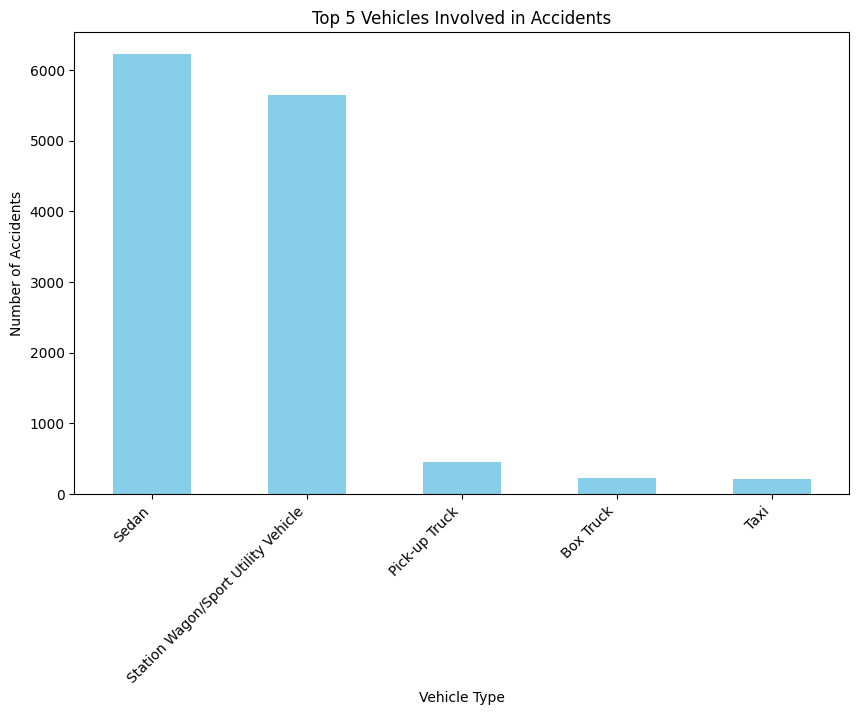

In [55]:
import pandas as pd
import matplotlib.pyplot as plt



# Extract relevant columns
vehicle_columns = ['VEHICLE TYPE CODE 1', 'VEHICLE TYPE CODE 2', 'VEHICLE TYPE CODE 3',
                    'VEHICLE TYPE CODE 4', 'VEHICLE TYPE CODE 5']

# Concatenate the vehicle type columns into a single Series
all_vehicles = pd.concat([summer_2019[column] for column in vehicle_columns], ignore_index=True)

# Drop missing values
all_vehicles = all_vehicles.dropna()

# Count the occurrences of each vehicle type
vehicle_counts = all_vehicles.value_counts().nlargest(5)

# Plotting the histogram
plt.figure(figsize=(10, 6))
vehicle_counts.plot(kind='bar', color='skyblue')

plt.title('Top 5 Vehicles Involved in Accidents')
plt.xlabel('Vehicle Type')
plt.ylabel('Number of Accidents')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.show()


<Figure size 1200x800 with 0 Axes>

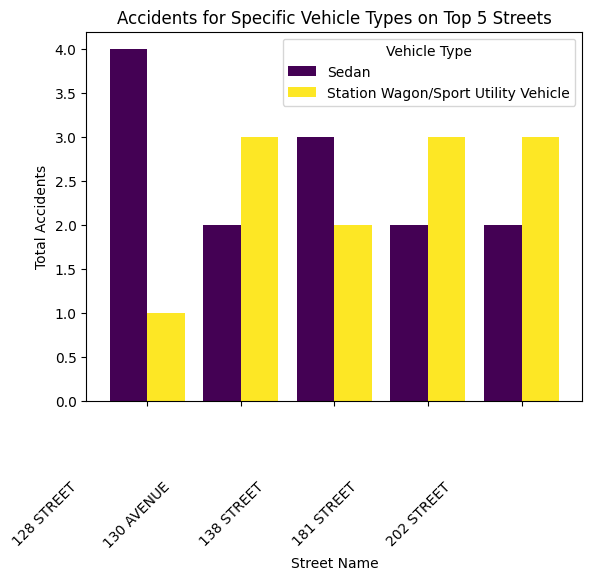

In [56]:
import pandas as pd
import matplotlib.pyplot as plt


# Filter out rows with missing values in relevant columns
filtered_df = summer_2020[['ON STREET NAME', 'VEHICLE TYPE CODE 1', 'VEHICLE TYPE CODE 2',
                          'VEHICLE TYPE CODE 3', 'VEHICLE TYPE CODE 4', 'VEHICLE TYPE CODE 5']].dropna()

# Identify the specific vehicle types
specific_vehicle_types = ['PASSENGER VEHICLE', 'Sedan', 'Station Wagon/Sport Utility Vehicle']

# Melt the DataFrame to consolidate the vehicle type columns
melted_df = filtered_df.melt(id_vars=['ON STREET NAME'], value_vars=['VEHICLE TYPE CODE 1', 'VEHICLE TYPE CODE 2',
                                                                      'VEHICLE TYPE CODE 3', 'VEHICLE TYPE CODE 4',
                                                                      'VEHICLE TYPE CODE 5'],
                             value_name='Vehicle Type')

# Filter the DataFrame to include only rows with the specified vehicle types
filtered_df = melted_df[melted_df['Vehicle Type'].isin(specific_vehicle_types)]

# Group by street name and vehicle type, count the number of accidents
street_accidents = filtered_df.groupby(['ON STREET NAME', 'Vehicle Type']).size().reset_index(name='Total Accidents')

# Find the top 5 streets based on the sum of accidents
top_5_streets = street_accidents.groupby('ON STREET NAME')['Total Accidents'].sum().nlargest(5).index.tolist()
top_5_streets_df = street_accidents[street_accidents['ON STREET NAME'].isin(top_5_streets)]

# Pivot the data for grouped bar plot
pivot_df = top_5_streets_df.pivot(index='ON STREET NAME', columns='Vehicle Type', values='Total Accidents').fillna(0)

# Plotting the grouped bar plot with side-by-side bars
plt.figure(figsize=(12, 8))
pivot_df.plot(kind='bar', colormap='viridis', width=0.8)

plt.title('Accidents for Specific Vehicle Types on Top 5 Streets')
plt.xlabel('Street Name')
plt.ylabel('Total Accidents')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.legend(title='Vehicle Type')
plt.show()


In [57]:
july_2019 = queens_df[(queens_df['CRASH DATE'].dt.month == 7) & (queens_df['CRASH DATE'].dt.year == 2019)]
july_2020 = queens_df[(queens_df['CRASH DATE'].dt.month == 7) & (queens_df['CRASH DATE'].dt.year == 2020)]

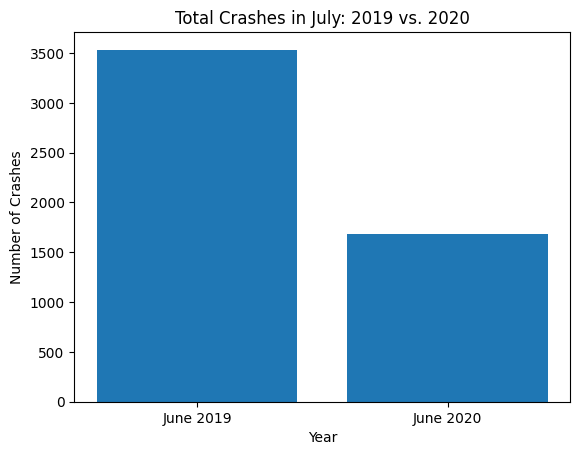

In [58]:
plt.bar(['June 2019', 'June 2020'], [len(july_2019), len(july_2020)])
plt.title('Total Crashes in July: 2019 vs. 2020')
plt.xlabel('Year')
plt.ylabel('Number of Crashes')
plt.show()

In [59]:
print(july_2019[attributes_to_compare].sum())
print(july_2020[attributes_to_compare].sum())

NUMBER OF PERSONS INJURED        974.0
NUMBER OF PERSONS KILLED           3.0
NUMBER OF PEDESTRIANS INJURED     94.0
NUMBER OF PEDESTRIANS KILLED       2.0
NUMBER OF CYCLIST INJURED         77.0
NUMBER OF CYCLIST KILLED           0.0
NUMBER OF MOTORIST INJURED       803.0
NUMBER OF MOTORIST KILLED          1.0
dtype: float64
NUMBER OF PERSONS INJURED        673.0
NUMBER OF PERSONS KILLED           3.0
NUMBER OF PEDESTRIANS INJURED     94.0
NUMBER OF PEDESTRIANS KILLED       1.0
NUMBER OF CYCLIST INJURED        112.0
NUMBER OF CYCLIST KILLED           0.0
NUMBER OF MOTORIST INJURED       467.0
NUMBER OF MOTORIST KILLED          2.0
dtype: float64


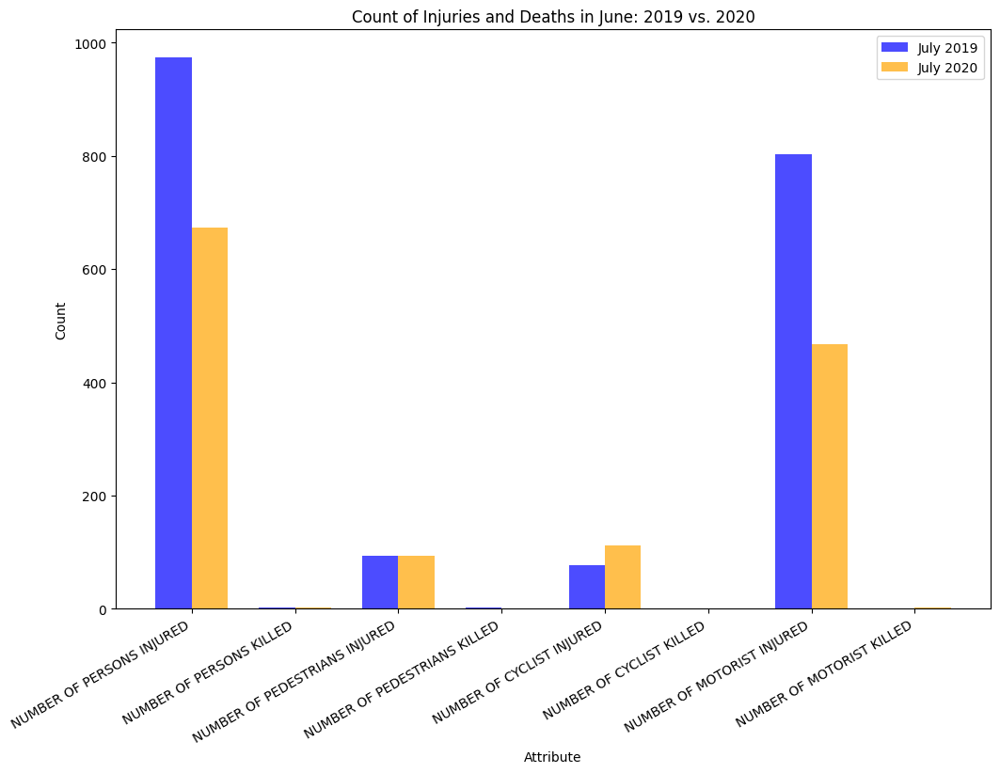

In [60]:
bar_width = 0.35
index = range(len(attributes_to_compare))

plt.figure(figsize=(12, 8))

# Bar chart for June 2019
plt.bar(index, july_2019[attributes_to_compare].sum(), bar_width, label='July 2019', color='blue', alpha=0.7)

# Bar chart for June 2020
plt.bar([i + bar_width for i in index], july_2020[attributes_to_compare].sum(), bar_width, label='July 2020', color='orange', alpha=0.7)

plt.title('Count of Injuries and Deaths in June: 2019 vs. 2020')
plt.xlabel('Attribute')
plt.ylabel('Count')
plt.xticks([i + bar_width/2 for i in index], attributes_to_compare, rotation=30, ha='right')
plt.legend()
plt.show()

In [61]:
# Define the start and end dates
start_date = pd.to_datetime('01/01/2019', format='%m/%d/%Y')
end_date = pd.to_datetime('10/31/2020', format='%m/%d/%Y')

# Filter the DataFrame for the specified date range
filtered_df = queens_df[(queens_df['CRASH DATE'] >= start_date) & (queens_df['CRASH DATE'] <= end_date)]

# Sort the DataFrame by 'CRASH DATE'
filtered_df = filtered_df.sort_values(by='CRASH DATE')


In [62]:
max_crashes = -1

start_date = filtered_df['CRASH DATE'].iloc[0]
start_d = start_date
end_d = start_date + pd.DateOffset(days=100)
end_date = start_date + pd.DateOffset(days=100)
while end_date <= filtered_df['CRASH DATE'].iloc[-1]:
  crashes_100_days = len(filtered_df[(filtered_df['CRASH DATE'] >= start_date) & (filtered_df['CRASH DATE'] < end_date)])
  if crashes_100_days > max_crashes:
    max_crashes = crashes_100_days
    start_d = start_date
    end_d = end_date
  start_date = start_date + pd.DateOffset(days=1)
  end_date = end_date + pd.DateOffset(days=1)


print("Start Date : ", start_d)
s = start_d
e = end_d
print("End Date: ", end_d)
print("Max Crashes: ", max_crashes)


Start Date :  2019-05-02 00:00:00
End Date:  2019-08-10 00:00:00
Max Crashes:  11739


In [63]:
queens_df['Day of Week'] = queens_df['CRASH DATE'].dt.dayofweek

# Group by day of the week and calculate the number of accidents
accidents_by_day = queens_df.groupby('Day of Week').size()

# Find the day with the most accidents
day_with_most_accidents = accidents_by_day.idxmax()


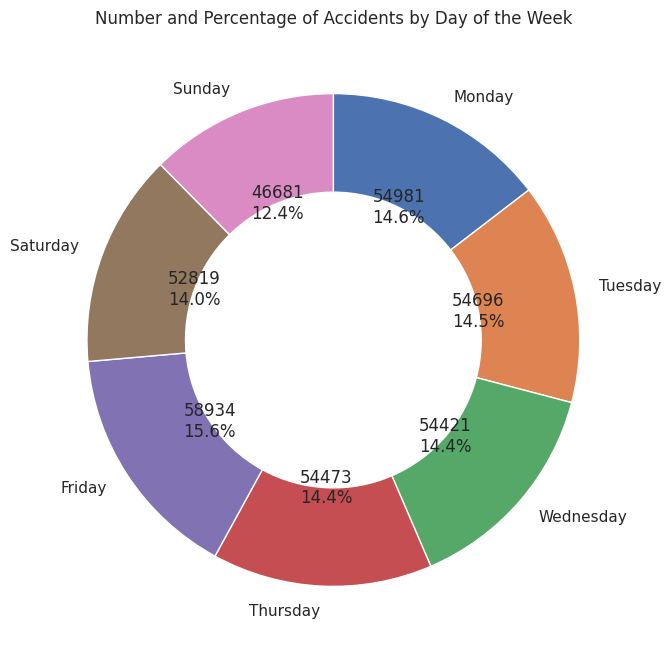

In [64]:
days_labels = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Plotting the pie chart using Seaborn and Matplotlib
plt.figure(figsize=(8, 8))
sns.set(style="whitegrid")
sns.color_palette("pastel")
plt.pie(accidents_by_day, labels=days_labels, autopct=lambda p: f'{int(p*sum(accidents_by_day)/100)}\n{p:.1f}%', startangle=90, counterclock=False, wedgeprops=dict(width=0.4))
plt.title('Number and Percentage of Accidents by Day of the Week')
plt.show()

In [65]:
day_mapping = {
    0: 'Monday',
    1: 'Tuesday',
    2: 'Wednesday',
    3: 'Thursday',
    4: 'Friday',
    5: 'Saturday',
    6: 'Sunday'
}
most_accidents_day_name = day_mapping[day_with_most_accidents]
print(f"The day of the week with the most accidents is: {most_accidents_day_name}")
print(f"Number of accidents on {most_accidents_day_name}: {accidents_by_day.max()}")

The day of the week with the most accidents is: Friday
Number of accidents on Friday: 58935


In [66]:
queens_df['Hour of Day'] = queens_df['CRASH TIME'].dt.hour

# Group by hour of the day and calculate the number of accidents
accidents_by_hour = queens_df.groupby('Hour of Day').size().reset_index(name='Accidents')

# Find the hour with the most accidents
hour_with_most_accidents = accidents_by_hour.idxmax()
print(accidents_by_hour)
# Print the result
print(f"The hour of the day with the most accidents is: {hour_with_most_accidents} o'clock")
print(f"Number of accidents at {hour_with_most_accidents} o'clock: {accidents_by_hour.max()}")


    Hour of Day  Accidents
0             0      10459
1             1       5625
2             2       4497
3             3       4261
4             4       5082
5             5       5622
6             6       8434
7             7      11478
8             8      23089
9             9      20271
10           10      18243
11           11      19136
12           12      20612
13           13      21749
14           14      25757
15           15      23615
16           16      26927
17           17      27166
18           18      24063
19           19      19625
20           20      16317
21           21      13493
22           22      12097
23           23       9392
The hour of the day with the most accidents is: Hour of Day    23
Accidents      17
dtype: int64 o'clock
Number of accidents at Hour of Day    23
Accidents      17
dtype: int64 o'clock: Hour of Day       23
Accidents      27166
dtype: int64


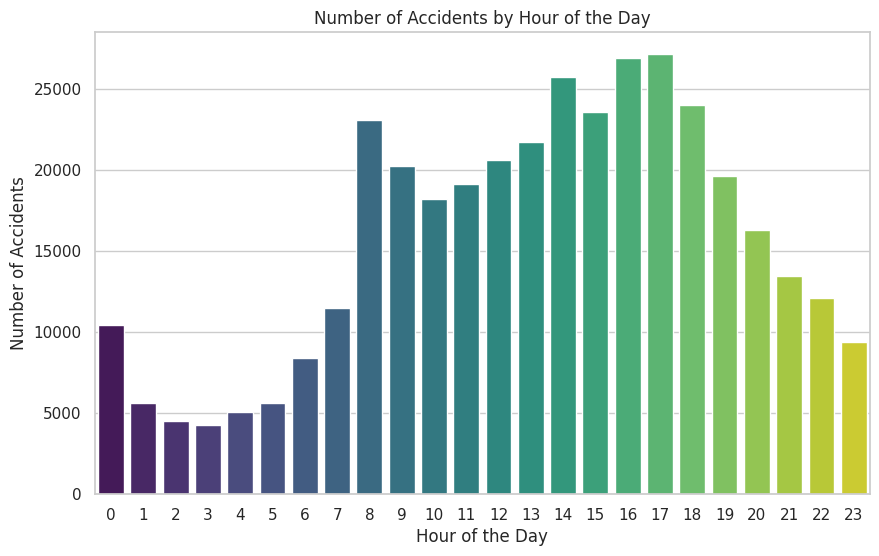

In [67]:
accidents_by_hour = queens_df.groupby('Hour of Day').size().reset_index(name='Accidents')

# Rename the column to a simpler name
accidents_by_hour = accidents_by_hour.rename(columns={'Hour of Day': 'HourOfDay'})

# Plotting the bar chart using Seaborn
plt.figure(figsize=(10, 6))
sns.set(style="whitegrid")
sns.barplot(x='HourOfDay', y='Accidents', data=accidents_by_hour, palette="viridis")
plt.title('Number of Accidents by Hour of the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Accidents')
plt.show()

In [68]:
filtered_df_2020 = queens_df[(filtered_df['CRASH DATE'] >= '2020-01-01') & (queens_df['CRASH DATE'] <= '2020-12-31')]

# Group by day and calculate the number of accidents
accidents_by_day_2020 = filtered_df_2020.groupby(filtered_df_2020['CRASH DATE'].dt.date).size()

# Find the top 12 days with the most accidents in 2020
top_12_days_2020 = accidents_by_day_2020.nlargest(12)

# Print the result
print("Top 12 days with the most accidents in 2020:")
print(top_12_days_2020)

Top 12 days with the most accidents in 2020:
CRASH DATE
2020-01-18    183
2020-01-13    123
2020-03-06    123
2020-02-14    120
2020-02-10    119
2020-02-07    113
2020-01-21    112
2020-01-29    112
2020-01-14    110
2020-02-06    109
2020-01-15    105
2020-02-03    104
dtype: int64


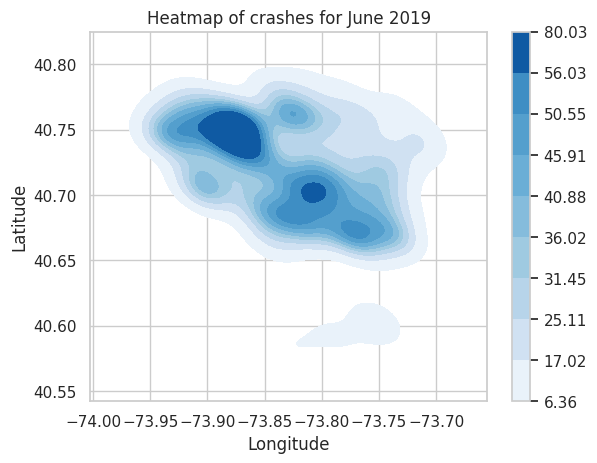

In [69]:

from sklearn.cluster import DBSCAN

# filtered_df = ny_crash_df[ny_crash_df['BOROUGH']=="QUEENS"]

filtered_df = queens_df[
    ((queens_df['CRASH DATE'].dt.month == 6) & (queens_df['CRASH DATE'].dt.year == 2019))
]
# # Drop NaN values if any
filtered_df = filtered_df.dropna(subset=['LATITUDE', 'LONGITUDE'])

# # Extract features
features = filtered_df[['LATITUDE', 'LONGITUDE']]

# # Apply DBSCAN
# dbscan = DBSCAN(eps=0.01, min_samples=5)  # Adjust eps and min_samples based on your data
# filtered_df['cluster'] = dbscan.fit_predict(features)
# print(filtered_df)
# # # Plot the results
# # plt.figure(figsize=(10, 8))

# # # You can choose between a heatmap or a contour map
# # # Heatmap
# # sns.scatterplot(x='LONGITUDE', y='LATITUDE', hue='cluster', data=filtered_df, cmap='viridis', alpha=0.5, s=5)

# # # Contour map
sns.kdeplot(x='LONGITUDE', y='LATITUDE', data=features, cmap='Blues', fill=True, cbar=True)

# Set labels and title
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Heatmap of crashes for June 2019')

# # # Show the plot
plt.show()


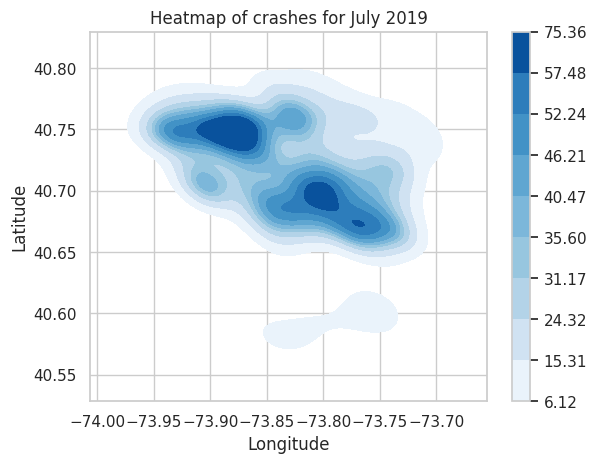

In [70]:
filtered_df = queens_df[
    ((queens_df['CRASH DATE'].dt.month == 7) & (queens_df['CRASH DATE'].dt.year == 2019))
]
# # Drop NaN values if any
filtered_df = filtered_df.dropna(subset=['LATITUDE', 'LONGITUDE'])

# # Extract features
features = filtered_df[['LATITUDE', 'LONGITUDE']]

# # Apply DBSCAN
# dbscan = DBSCAN(eps=0.01, min_samples=5)  # Adjust eps and min_samples based on your data
# filtered_df['cluster'] = dbscan.fit_predict(features)
# print(filtered_df)
# # # Plot the results
# # plt.figure(figsize=(10, 8))

# # # You can choose between a heatmap or a contour map
# # # Heatmap
# # sns.scatterplot(x='LONGITUDE', y='LATITUDE', hue='cluster', data=filtered_df, cmap='viridis', alpha=0.5, s=5)

# # # Contour map
sns.kdeplot(x='LONGITUDE', y='LATITUDE', data=features, cmap='Blues', fill=True, cbar=True)

# Set labels and title
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Heatmap of crashes for July 2019')

# # # Show the plot
plt.show()

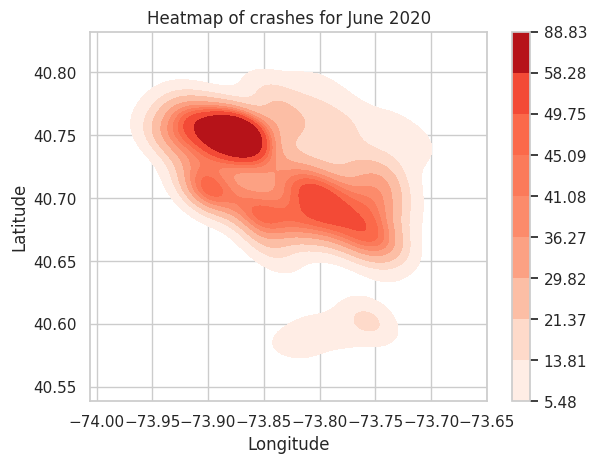

In [71]:
filtered_df = queens_df[
    ((queens_df['CRASH DATE'].dt.month == 7) & (queens_df['CRASH DATE'].dt.year == 2020))
]
# # Drop NaN values if any
filtered_df = filtered_df.dropna(subset=['LATITUDE', 'LONGITUDE'])

# # Extract features
features = filtered_df[['LATITUDE', 'LONGITUDE']]

# # Apply DBSCAN
# dbscan = DBSCAN(eps=0.01, min_samples=5)  # Adjust eps and min_samples based on your data
# filtered_df['cluster'] = dbscan.fit_predict(features)
# print(filtered_df)
# # # Plot the results
# # plt.figure(figsize=(10, 8))

# # # You can choose between a heatmap or a contour map
# # # Heatmap
# # sns.scatterplot(x='LONGITUDE', y='LATITUDE', hue='cluster', data=filtered_df, cmap='viridis', alpha=0.5, s=5)

# # # Contour map
sns.kdeplot(x='LONGITUDE', y='LATITUDE', data=features, cmap='Reds', fill=True, cbar=True)

# Set labels and title
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Heatmap of crashes for June 2020')

# # # Show the plot
plt.show()

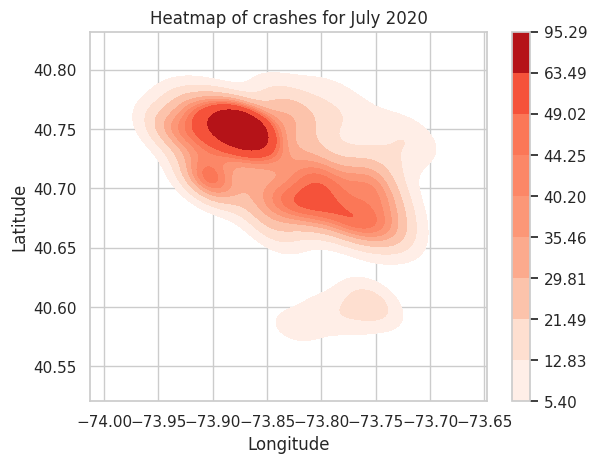

In [72]:
# queens_df = ny_crash_df[ny_crash_df['BOROUGH']=="QUEENS"]
# queens_df['CRASH DATE'] = pd.to_datetime(queens_df['CRASH DATE'], errors='coerce', format='%m/%d/%Y')
# queens_df['CRASH TIME'] = pd.to_datetime(queens_df['CRASH TIME'], errors='coerce', format='%H:%M')
filtered_df = queens_df[
    ((queens_df['CRASH DATE'].dt.month == 6) & (queens_df['CRASH DATE'].dt.year == 2020))
]


# # Drop NaN values if any
filtered_df = filtered_df.dropna(subset=['LATITUDE', 'LONGITUDE'])
latitudes_range = (40.549517, 40.8)
longitudes_range = (-73.962007, -73.7004)

# Filter data within the specified range
filtered_df = filtered_df[(filtered_df['LATITUDE'] >= latitudes_range[0]) & (filtered_df['LATITUDE'] <= latitudes_range[1]) &
                          (filtered_df['LONGITUDE'] >= longitudes_range[0]) & (filtered_df['LONGITUDE'] <= longitudes_range[1])]

# # Extract features
features = filtered_df[['LATITUDE', 'LONGITUDE']]

# # Apply DBSCAN
# dbscan = DBSCAN(eps=0.01, min_samples=5)  # Adjust eps and min_samples based on your data
# filtered_df['cluster'] = dbscan.fit_predict(features)
# print(filtered_df)
# # # Plot the results
# # plt.figure(figsize=(10, 8))

# # # You can choose between a heatmap or a contour map
# # # Heatmap
# # sns.scatterplot(x='LONGITUDE', y='LATITUDE', hue='cluster', data=filtered_df, cmap='viridis', alpha=0.5, s=5)

# # # Contour map
sns.kdeplot(x='LONGITUDE', y='LATITUDE', data=features, cmap='Reds', cbar=True, fill=True)

# Set labels and title
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Heatmap of crashes for July 2020')

# # # Show the plot
plt.show()

In [89]:
import folium
from folium import plugins


filtered_df = june_2019[['LATITUDE', 'LONGITUDE']].dropna()
latitudes_range = (40.549517, 40.8)
longitudes_range = (-73.962007, -73.7004)

# Filter data within the specified range
filtered_df = filtered_df[(filtered_df['LATITUDE'] >= latitudes_range[0]) & (filtered_df['LATITUDE'] <= latitudes_range[1]) &
                          (filtered_df['LONGITUDE'] >= longitudes_range[0]) & (filtered_df['LONGITUDE'] <= longitudes_range[1])]
# # Extract features
features = filtered_df[['LATITUDE', 'LONGITUDE']]

# Extract latitudes and longitudes
latitudes = filtered_df['LATITUDE']
longitudes = filtered_df['LONGITUDE']

# Creating a base map
map_queens = folium.Map(location=[latitudes.mean(), longitudes.mean()], zoom_start=11)

# Adding a heatmap layer to the map
heat_data = list(zip(latitudes, longitudes))
folium.plugins.HeatMap(heat_data, radius=17).add_to(map_queens)

# Display the map
map_queens

In [90]:
filtered_df = june_2020[['LATITUDE', 'LONGITUDE']].dropna()
latitudes_range = (40.549517, 40.8)
longitudes_range = (-73.962007, -73.7004)

# Filter data within the specified range
filtered_df = filtered_df[(filtered_df['LATITUDE'] >= latitudes_range[0]) & (filtered_df['LATITUDE'] <= latitudes_range[1]) &
                          (filtered_df['LONGITUDE'] >= longitudes_range[0]) & (filtered_df['LONGITUDE'] <= longitudes_range[1])]
# # Extract features
features = filtered_df[['LATITUDE', 'LONGITUDE']]

# Extract latitudes and longitudes
latitudes = filtered_df['LATITUDE']
longitudes = filtered_df['LONGITUDE']

# Creating a base map
map_queens = folium.Map(location=[latitudes.mean(), longitudes.mean()], zoom_start=11)

# Adding a heatmap layer to the map
heat_data = list(zip(latitudes, longitudes))
folium.plugins.HeatMap(heat_data, radius=17).add_to(map_queens)

# Display the map
map_queens


In [91]:
filtered_df = july_2019[['LATITUDE', 'LONGITUDE']].dropna()
latitudes_range = (40.549517, 40.8)
longitudes_range = (-73.962007, -73.7004)

# Filter data within the specified range
filtered_df = filtered_df[(filtered_df['LATITUDE'] >= latitudes_range[0]) & (filtered_df['LATITUDE'] <= latitudes_range[1]) &
                          (filtered_df['LONGITUDE'] >= longitudes_range[0]) & (filtered_df['LONGITUDE'] <= longitudes_range[1])]
# # Extract features
features = filtered_df[['LATITUDE', 'LONGITUDE']]

# Extract latitudes and longitudes
latitudes = filtered_df['LATITUDE']
longitudes = filtered_df['LONGITUDE']

# Creating a base map
map_queens = folium.Map(location=[latitudes.mean(), longitudes.mean()], zoom_start=11)

# Adding a heatmap layer to the map
heat_data = list(zip(latitudes, longitudes))
folium.plugins.HeatMap(heat_data, radius=17).add_to(map_queens)

# Display the map
map_queens

In [92]:

filtered_df = july_2020[['LATITUDE', 'LONGITUDE']].dropna()
latitudes_range = (40.549517, 40.8)
longitudes_range = (-73.962007, -73.7004)

# Filter data within the specified range
filtered_df = filtered_df[(filtered_df['LATITUDE'] >= latitudes_range[0]) & (filtered_df['LATITUDE'] <= latitudes_range[1]) &
                          (filtered_df['LONGITUDE'] >= longitudes_range[0]) & (filtered_df['LONGITUDE'] <= longitudes_range[1])]
# # Extract features
features = filtered_df[['LATITUDE', 'LONGITUDE']]

# Extract latitudes and longitudes
latitudes = filtered_df['LATITUDE']
longitudes = filtered_df['LONGITUDE']

# Creating a base map
map_queens = folium.Map(location=[latitudes.mean(), longitudes.mean()], zoom_start=11)

# Adding a heatmap layer to the map
heat_data = list(zip(latitudes, longitudes))
folium.plugins.HeatMap(heat_data, radius=17).add_to(map_queens)

# Display the map
map_queens

In [74]:

import folium
from sklearn.cluster import DBSCAN



# Filter out rows with missing values in latitude and longitude columns
filtered_df = summer_2019[['LATITUDE', 'LONGITUDE']].dropna()

# Extract latitudes and longitudes
latitudes = filtered_df['LATITUDE']
longitudes = filtered_df['LONGITUDE']

# Restrict the range of latitude and longitude
latitudes_range = (40.549517, 40.8)
longitudes_range = (-73.962007, -73.7004)

# Filter data within the specified range
filtered_df = filtered_df[(filtered_df['LATITUDE'] >= latitudes_range[0]) & (filtered_df['LATITUDE'] <= latitudes_range[1]) &
                          (filtered_df['LONGITUDE'] >= longitudes_range[0]) & (filtered_df['LONGITUDE'] <= longitudes_range[1])]

# Extract features
features = filtered_df[['LATITUDE', 'LONGITUDE']]

# Apply DBSCAN
dbscan = DBSCAN(eps=0.01, min_samples=5)
filtered_df['cluster'] = dbscan.fit_predict(features)
filtered_df.to_csv('Clustered data')
# Create a folium map centered at the mean latitude and longitude
map_queens = folium.Map(location=[latitudes.mean(), longitudes.mean()], zoom_start=13)

# Add cluster markers to the map
for index, row in filtered_df.iterrows():
    folium.CircleMarker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=2,
        color=f'#{int(row["cluster"]) % 16777215:X}',  # Convert to integer before formatting
        fill=True,
        fill_color=f'#{int(row["cluster"]) % 16777215:X}',  # Convert to integer before formatting
        fill_opacity=0.3,
        popup=f'Cluster: {row["cluster"]}'
    ).add_to(map_queens)

# Display the map
map_queens


In [76]:
import folium
from sklearn.cluster import DBSCAN
import pandas as pd
import seaborn as sns

# Filter out rows with missing values in latitude and longitude columns for 2019
filtered_df_2019 = summer_2019[['LATITUDE', 'LONGITUDE']].dropna()

# Filter out rows with missing values in latitude and longitude columns for 2020
filtered_df_2020 = summer_2020[['LATITUDE', 'LONGITUDE']].dropna()

# Extract features for 2019
features_2019 = filtered_df_2019[['LATITUDE', 'LONGITUDE']]

# Extract features for 2020
features_2020 = filtered_df_2020[['LATITUDE', 'LONGITUDE']]

# Apply DBSCAN for 2019
dbscan_2019 = DBSCAN(eps=0.01, min_samples=5)
filtered_df_2019['cluster'] = dbscan_2019.fit_predict(features_2019)

# Apply DBSCAN for 2020
dbscan_2020 = DBSCAN(eps=0.01, min_samples=5)
filtered_df_2020['cluster'] = dbscan_2020.fit_predict(features_2020)

# Create a folium map centered at the mean latitude and longitude
map_queens = folium.Map(location=[filtered_df_2019['LATITUDE'].mean(), filtered_df_2019['LONGITUDE'].mean()], zoom_start=13)

# Define color palettes for 2019 and 2020
color_palette_2019 = sns.color_palette("husl", n_colors=len(filtered_df_2019['cluster'].unique()))
color_palette_2020 = sns.color_palette("husl", n_colors=len(filtered_df_2020['cluster'].unique()))

color_palette_2020_new = []
"""for i in color_palette_2020:
  temp = []
  for j in i:
    temp.append(j + 400)
  color_palette_2020_new.append(temp)"""
#color_palette_2020 = color_palette_2020_new
print(color_palette_2019)
print(color_palette_2020)

# Add cluster markers for 2019 to the map
for index, row in filtered_df_2019.iterrows():
    cluster_label = int(row["cluster"])
    cluster_color = "#{:02x}{:02x}{:02x}".format(int(color_palette_2019[cluster_label][0] * 255),
                                                  int(color_palette_2019[cluster_label][1] * 255),
                                                  int(color_palette_2019[cluster_label][2] * 255))
    folium.CircleMarker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=2,
        color=cluster_color,
        fill=True,
        fill_color=cluster_color,
        fill_opacity=0.3,
        popup=f'Cluster (2019): {row["cluster"]}'
    ).add_to(map_queens)

# Add cluster markers for 2020 to the map
for index, row in filtered_df_2020.iterrows():
    cluster_label = int(row["cluster"])
    cluster_color = "#{:02x}{:02x}{:02x}".format(int(color_palette_2020[cluster_label][0] * 35),
                                                  int(color_palette_2020[cluster_label][1] * 35),
                                                  int(color_palette_2020[cluster_label][2] * 235))
    folium.CircleMarker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=3,
        color=cluster_color,
        fill=True,
        fill_color=cluster_color,
        fill_opacity=0.3,
        popup=f'Cluster (2020): {row["cluster"]}'
    ).add_to(map_queens)

# Add labels for 2019 and 2020
folium.Marker(
    location=[filtered_df_2019['LATITUDE'].mean(), filtered_df_2019['LONGITUDE'].mean()],
    icon=folium.Icon(color='red'),
    popup='Year: 2019'
).add_to(map_queens)

folium.Marker(
    location=[filtered_df_2020['LATITUDE'].mean(), filtered_df_2020['LONGITUDE'].mean()],
    icon=folium.Icon(color='blue'),
    popup='Year: 2020'
).add_to(map_queens)


# Display the map
map_queens


[(0.9677975592919913, 0.44127456009157356, 0.5358103155058701), (0.5920891529639701, 0.6418467016378244, 0.1935069134991043), (0.21044753832183283, 0.6773105080456748, 0.6433941168468681), (0.6423044349219739, 0.5497680051256467, 0.9582651433656727)]
[(0.9677975592919913, 0.44127456009157356, 0.5358103155058701), (0.5920891529639701, 0.6418467016378244, 0.1935069134991043), (0.21044753832183283, 0.6773105080456748, 0.6433941168468681), (0.6423044349219739, 0.5497680051256467, 0.9582651433656727)]


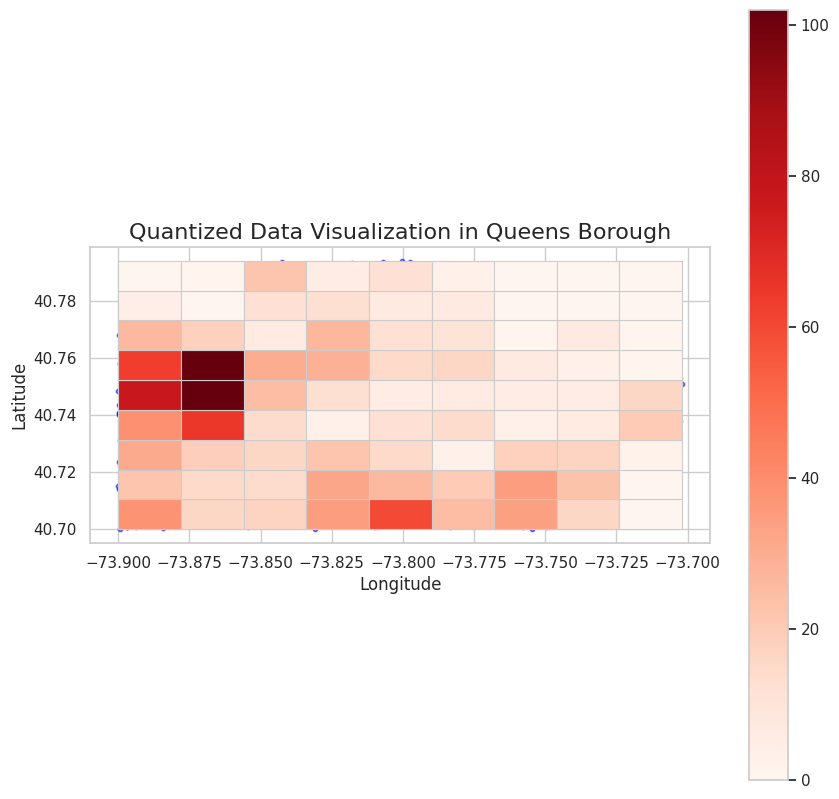

In [77]:
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point, Polygon
import numpy as np
latitudes_range = (40.7, 40.8)
longitudes_range = (-73.9, -73.7004)

# Filter data within the specified range
filtered_df = filtered_df[(filtered_df['LATITUDE'] >= latitudes_range[0]) & (filtered_df['LATITUDE'] <= latitudes_range[1]) &
                          (filtered_df['LONGITUDE'] >= longitudes_range[0]) & (filtered_df['LONGITUDE'] <= longitudes_range[1])]

# Assuming 'queens_df' is your DataFrame with 'LATITUDE' and 'LONGITUDE' columns
geometry = [Point(xy) for xy in zip(filtered_df['LONGITUDE'], filtered_df['LATITUDE'])]
geo_df = gpd.GeoDataFrame(filtered_df, geometry=geometry)

xmin, ymin, xmax, ymax = geo_df.total_bounds
x_bins = 10
y_bins = 10

hist, x_edges, y_edges = np.histogram2d(geo_df['LONGITUDE'], geo_df['LATITUDE'], bins=[np.linspace(xmin, xmax, x_bins), np.linspace(ymin, ymax, y_bins)])

grid_cells = []
for x in range(x_bins - 1):  # Adjusted loop range
    for y in range(y_bins - 1):  # Adjusted loop range
        polygon = Polygon([(x_edges[x], y_edges[y]), (x_edges[x + 1], y_edges[y]), (x_edges[x + 1], y_edges[y + 1]), (x_edges[x], y_edges[y + 1])])
        grid_cells.append({'geometry': polygon, 'count': hist[x, y]})

grid_df = gpd.GeoDataFrame(grid_cells)

fig, ax = plt.subplots(figsize=(10, 10))
geo_df.plot(ax=ax, markersize=10, color='blue', alpha=0.5)
grid_df.plot(column='count', cmap='Reds', linewidth=0.8, ax=ax, edgecolor='0.8', legend=True)

plt.title('Quantized Data Visualization in Queens Borough', fontsize=16)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()


In [78]:
import pandas as pd
import plotly.express as px

# Selecting contributing factor columns
contributing_factor_columns = ['CONTRIBUTING FACTOR VEHICLE 1', 'CONTRIBUTING FACTOR VEHICLE 2',
                                'CONTRIBUTING FACTOR VEHICLE 3', 'CONTRIBUTING FACTOR VEHICLE 4',
                                'CONTRIBUTING FACTOR VEHICLE 5']

# Combine all contributing factor columns into a single column
filtered_df = queens_df[contributing_factor_columns].stack().reset_index(level=0).rename(columns={0: 'Contributing Factor'})

# Exclude the "Unspecified" category
filtered_df = filtered_df[filtered_df['Contributing Factor'] != 'Unspecified']

# Count the occurrences of each contributing factor
reasons_count = filtered_df['Contributing Factor'].value_counts().reset_index(name='Accident Count')

# Select the top 10 reasons
top_10_reasons = reasons_count.head(10)

# Add a numerical column for coloring based on Accident Count
top_10_reasons['Color'] = range(1, len(top_10_reasons) + 1)

# Plotting the interactive bar graph using Plotly Express
fig = px.bar(top_10_reasons, x='Accident Count', y='index', orientation='h', text='Accident Count',
             color='Color', color_continuous_scale='blues_r',  # '_r' reverses the color scale
             labels={'index': 'Contributing Factors', 'Accident Count': 'Number of Accidents'},
             title='Top 10 Reasons for Accidents in Queens')

# Customize text color to golden
fig.update_traces(marker_line_color='black', marker_line_width=1, opacity=0.7,
                  texttemplate='%{text}', textfont_color='forestgreen')

fig.update_layout(showlegend=False)

# Show the plot
fig.show()



<ipython-input-78-3b211555ff7b>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_10_reasons['Color'] = range(1, len(top_10_reasons) + 1)


In [79]:
import pandas as pd
import plotly.express as px


# Selecting contributing factor columns
contributing_factor_columns = ['CONTRIBUTING FACTOR VEHICLE 1', 'CONTRIBUTING FACTOR VEHICLE 2',
                                'CONTRIBUTING FACTOR VEHICLE 3', 'CONTRIBUTING FACTOR VEHICLE 4',
                                'CONTRIBUTING FACTOR VEHICLE 5']

# Combine all contributing factor columns into a single column
filtered_df = summer_2020[contributing_factor_columns].stack().reset_index(level=0).rename(columns={0: 'Contributing Factor'})

# Exclude the "Unspecified" category
filtered_df = filtered_df[filtered_df['Contributing Factor'] != 'Unspecified']

# Count the occurrences of each contributing factor
reasons_count = filtered_df['Contributing Factor'].value_counts().reset_index(name='Accident Count')

# Select the top 10 reasons
top_10_reasons = reasons_count.head(10)

# Add a numerical column for coloring based on Accident Count
top_10_reasons['Color'] = range(1, len(top_10_reasons) + 1)

# Plotting the interactive bar graph using Plotly Express
fig = px.bar(top_10_reasons, x='Accident Count', y='index', orientation='h', text='Accident Count',
             color='Color', color_continuous_scale='blues_r',  # '_r' reverses the color scale
             labels={'index': 'Contributing Factors', 'Accident Count': 'Number of Accidents'},
             title='Top 10 Reasons for Accidents in Queens')

# Customize text color to golden
fig.update_traces(marker_line_color='black', marker_line_width=1, opacity=0.7,
                  texttemplate='%{text}', textfont_color='forestgreen')

fig.update_layout(showlegend=False)

# Show the plot
fig.show()




<ipython-input-79-a434098c0d80>:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



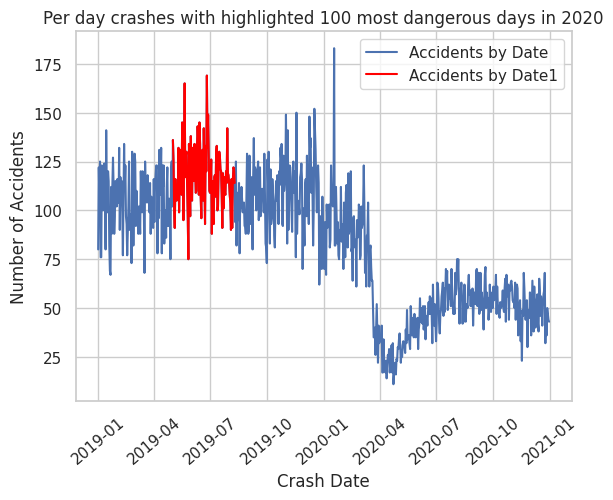

In [80]:
import pandas as pd
import plotly.express as px


start_d1 = pd.to_datetime('2019-01-01')
end_d1 = pd.to_datetime('2020-12-31')

# Filter data for the specified time frame
filtered_df = queens_df[(queens_df['CRASH DATE'] >= start_d1) & (queens_df['CRASH DATE'] <= end_d1)]
filtered_df1 = queens_df[(queens_df['CRASH DATE'] >= s) & (queens_df['CRASH DATE'] <= e)]

# Group by crash date and count the number of accidents
accidents_by_date = filtered_df.groupby('CRASH DATE').size().reset_index(name='Accident Count')
accidents_by_date1 = filtered_df1.groupby('CRASH DATE').size().reset_index(name='Accident Count')

# Create a new column indicating whether the date is within the specified range
accidents_by_date['InRange'] = (accidents_by_date['CRASH DATE'] >= start_d1) & (accidents_by_date['CRASH DATE'] <= end_d1)
accidents_by_date1['InRange'] = (accidents_by_date1['CRASH DATE'] >= s) & (accidents_by_date1['CRASH DATE'] <= e)

plt.plot(accidents_by_date['CRASH DATE'], accidents_by_date['Accident Count'], label='Accidents by Date')

# Plotting the line graph for accidents_by_date1 with a different zorder
plt.plot(accidents_by_date1['CRASH DATE'], accidents_by_date1['Accident Count'], label='Accidents by Date1', color='red', zorder=3)

# Customize plot
plt.xlabel('Crash Date')
plt.xticks(rotation=40)
plt.ylabel('Number of Accidents')
plt.title('Per day crashes with highlighted 100 most dangerous days in 2020')
plt.legend()

# Show the plot
plt.show()


In [81]:
queens_df['Day of Week'] = queens_df['CRASH DATE'].dt.dayofweek


# Group by day of the week and calculate the number of accidents
# accidents_by_day = queens_df.groupby('Day of Week')

# print(accidents_by_day)
result = []
for i in range(7):
  day_df = queens_df[queens_df['Day of Week']==i]
  # print(accidents_by_day)
  day_df['Hour of Day'] = day_df['CRASH TIME'].dt.hour
  accidents_by_hour = day_df.groupby('Hour of Day').size().reset_index(name='Accidents')
  #print(accidents_by_hour)
  # Find the hour with the most accidents
  hour_with_most_accidents = accidents_by_hour['Accidents'].idxmax()
  result.append(hour_with_most_accidents)
  # Print the result
  print(f"The hour of the day with the most accidents is on day : {i} is : {hour_with_most_accidents} o'clock")
  # print(f"Number of accidents at {hour_with_most_accidents} o'clock: {accidents_by_hour.max()}")

<ipython-input-81-799d5fbbd0f6>:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-81-799d5fbbd0f6>:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-81-799d5fbbd0f6>:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-81-799d

The hour of the day with the most accidents is on day : 0 is : 17 o'clock
The hour of the day with the most accidents is on day : 1 is : 17 o'clock
The hour of the day with the most accidents is on day : 2 is : 17 o'clock
The hour of the day with the most accidents is on day : 3 is : 17 o'clock
The hour of the day with the most accidents is on day : 4 is : 17 o'clock
The hour of the day with the most accidents is on day : 5 is : 14 o'clock
The hour of the day with the most accidents is on day : 6 is : 14 o'clock


<ipython-input-81-799d5fbbd0f6>:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-81-799d5fbbd0f6>:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-81-799d5fbbd0f6>:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



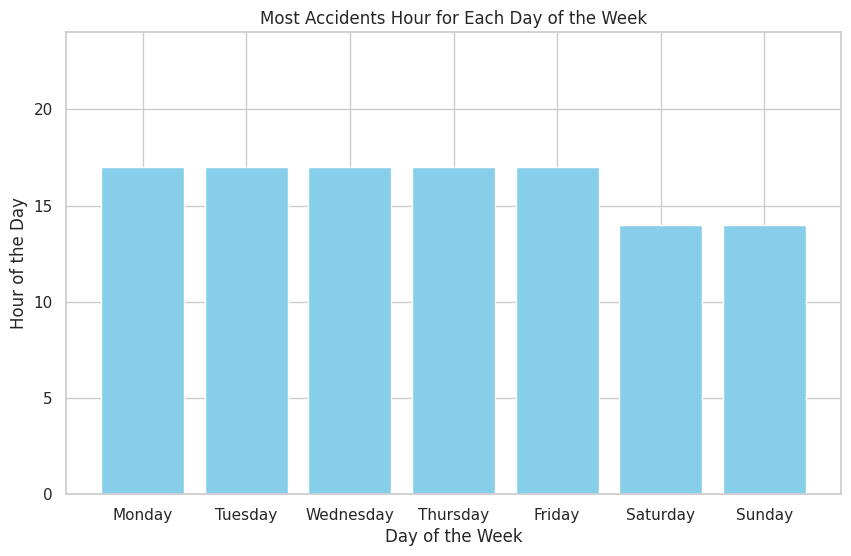

In [82]:
import matplotlib.pyplot as plt


# Days of the week labels
days_labels = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Plotting the bar chart
plt.figure(figsize=(10, 6))
plt.bar(days_labels, result, color='skyblue')
plt.title('Most Accidents Hour for Each Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Hour of the Day')
plt.ylim(0, 24)  # Set y-axis limit to 24 hours

# Display the plot
plt.show()
